<a href="https://colab.research.google.com/github/L98S/agriculture-in-india/blob/main/Exploring_Crop_Production_Patterns_and_Trends_in_India_Insights%2C_Visualizations%2C_and_Analytical_Predictions.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

>[1.Introduction](#scrollTo=JTe8JPdbiNEz)

>>[About The Data:](#scrollTo=JTe8JPdbiNEz)

>[2.Load The Data](#scrollTo=9k6Npi-BjTU5)

>[3.Examine and impute missing values](#scrollTo=XTAoQki0YHwD)

>[4.Discover and Visualize the Data to Gain Insights](#scrollTo=gW8b0ssnv23K)

>[5-Answering analytical questions](#scrollTo=I0uYk18m4n3a)

>>[Q1: What are the most commonly grown crops in each state?](#scrollTo=_mv8KaUr8LWU)

>>[Q2: What is the highest crop production by season?](#scrollTo=9JxlTAh2qq_P)

>>[Q3: Are there any specific crops that consistently perform well across different seasons?](#scrollTo=1LY4K8kNH_uZ)

>>[Q4: Which State has the most production throughout the whole year?](#scrollTo=L9s_7yVxj8Qf)

>>[Q5:Which States have the highest production each season?](#scrollTo=G1_735yisma-)

>>[Q6:What is the distribution of crop production across different seasons?](#scrollTo=XGaAs26zDz0v)

>>[Q7: visualize the production changed in each state over the years](#scrollTo=U2-iVJNMHpJj)

>>[Q8:which year has the highest overall production?](#scrollTo=SUhbOVjuaMms)

>[6.Conclusion:](#scrollTo=GufFL3uvbTcD)

>[7.Until We Meet Again:](#scrollTo=HShucudKb5YW)



# 1.Introduction
India is a major player in agriculture on the global stage, offers a fascinating landscape for understanding crop prediction, seasonal impacts, regional influences on yield, and the evolving trends in agricultural forecasting.The main objectives of this project include data exploration, visualization, and addressing various analytical questions.
So, join me on this exploration of Indian agriculture.
Let's go!






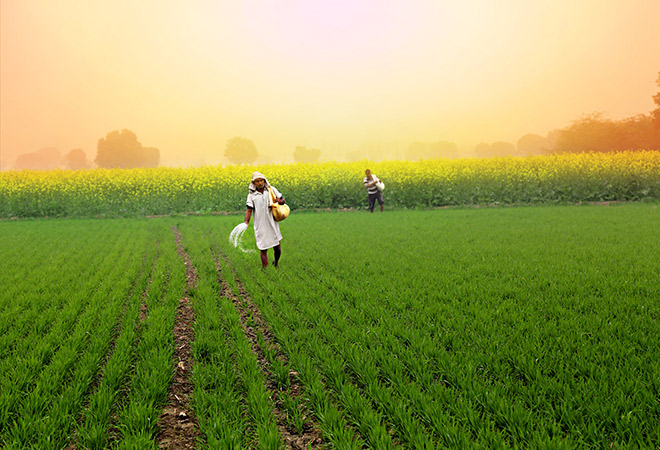




---

## About The Data:
This dataset, which I obtained from Kaggle, holds a wealth of valuable information sourced from the Indian government's Area Production Statistics (APS) database. Maintained by the Ministry of Agriculture and Farmers Welfare, the APS database offers comprehensive and detailed data on crop production, yield, and cultivated areas across various states and districts in India.
We also know from the data description on Kaggle that the units of the columns is as following Area (Hectares), Production (Tonnes), and Yield(Tonnes/Hectare)

# 2.Load The Data
Accessing and downloading data from Kaggle to Google Colab is straightforward, Just follow the code down below




In [ ]:
# Replace the placeholders with your Kaggle API credentials
import os
os.environ['KAGGLE_USERNAME'] = 'leen98'#placeholder
os.environ['KAGGLE_KEY'] = 'ff5566e54f542531929718d486bff81f'#placeholder


In [ ]:
!kaggle datasets download -d nikhilmahajan29/crop-production-statistics-india -f APY.csv

APY.csv.zip: Skipping, found more recently modified local copy (use --force to force download)


In [ ]:
import numpy as np
import pandas as pd

In [ ]:
df = pd.read_csv('/content/APY.csv.zip')

In [ ]:
# making sure that the columns names have no spaces in them
df = df.rename(columns=lambda x: x.replace(' ', ''))
df

,State,District,Crop,Crop_Year,Season,Area,Production,Yield
0,Andaman and Nicobar Island,NICOBARS,Arecanut,2007,Kharif,2439.6,3415.0,1.40
1,Andaman and Nicobar Island,NICOBARS,Arecanut,2007,Rabi,1626.4,2277.0,1.40
2,Andaman and Nicobar Island,NICOBARS,Arecanut,2008,Autumn,4147.0,3060.0,0.74
3,Andaman and Nicobar Island,NICOBARS,Arecanut,2008,Summer,4147.0,2660.0,0.64
4,Andaman and Nicobar Island,NICOBARS,Arecanut,2009,Autumn,4153.0,3120.0,0.75
...,...,...,...,...,...,...,...,...
345331,West Bengal,PURULIA,Wheat,2015,Rabi,855.0,1241.0,1.45
345332,West Bengal,PURULIA,Wheat,2016,Rabi,1366.0,2415.0,1.77
345333,West Bengal,PURULIA,Wheat,2017,Rabi,1052.0,2145.0,2.04
345334,West Bengal,PURULIA,Wheat,2018,Rabi,833.0,2114.0,2.54


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 345336 entries, 0 to 345335
Data columns (total 8 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   State       345336 non-null  object 
 1   District    345336 non-null  object 
 2   Crop        345327 non-null  object 
 3   Crop_Year   345336 non-null  int64  
 4   Season      345336 non-null  object 
 5   Area        345336 non-null  float64
 6   Production  340388 non-null  float64
 7   Yield       345336 non-null  float64
dtypes: float64(3), int64(1), object(4)
memory usage: 21.1+ MB


In [ ]:
df.describe()

,Crop_Year,Area,Production,Yield
count,345336.000000,3.453360e+05,3.403880e+05,345336.000000
mean,2008.887512,1.167147e+04,9.584726e+05,79.423135
std,6.564361,4.584079e+04,2.153068e+07,916.678396
min,1997.000000,4.000000e-03,0.000000e+00,0.000000
25%,2003.000000,7.400000e+01,8.700000e+01,0.550000
50%,2009.000000,5.320000e+02,7.170000e+02,1.000000
75%,2015.000000,4.112000e+03,7.182000e+03,2.470000
max,2020.000000,8.580100e+06,1.597800e+09,43958.330000


-Okay, I know we should wait before making any concrete conclusions, but I couldn't resist diving into the numbers! Here are some initial observations I've made. Of course, we need to take everything with a grain of salt since we'll be examining and analyzing everything in more depth:


* In the yield column the 75th percentile value of 2.47 tonnes/hectare indicates
that the majority of the yield data in the dataset is less than 3 tonnes/hectare. This aligns with the expectation that the yield values would typically be lower since we are measuring the amount of production per hectare.

* In the Production column it appears that there may be some extreme values in the production column that are pulling the mean value up. Since the mean production value is approximately 958,472 units, while the 75th percentile value is 7,182 units, it suggests that there might be a few instances with significantly higher production values that are skewing the average.

* The data is covering the years from 1997 to 2020

* looks like there are some columns with missing values.




In this project, I aim to create interactive maps of India to explore and analyze various geographical data. To ensure accurate analysis and data consistency, I will align the state names in the GeoJSON file with those in the dataset. This step is crucial in generating accurate and meaningful visual representations of the data, allowing us to gain valuable insights into India's diverse regions.

In [ ]:
#getting the geojson file
import requests
import json
geojson_url = "https://gist.githubusercontent.com/jbrobst/56c13bbbf9d97d187fea01ca62ea5112/raw/e388c4cae20aa53cb5090210a42ebb9b765c0a36/india_states.geojson"
response = requests.get(geojson_url)
geojson_data = response.json()


In [ ]:
#getting the names of the states in the file
state_names = []
for feature in geojson_data["features"]:
    state_names.append(feature["properties"]["ST_NM"])

In [ ]:
#checking the states names to find in if their is a data mismatch
for state in df["State"].unique():
    if state not in state_names:
        print("State name not found:", state)

State name not found: Andaman and Nicobar Island
State name not found: CHANDIGARH
State name not found: Dadra and Nagar Haveli
State name not found: Daman and Diu
State name not found: Jammu and Kashmir
State name not found: Laddak
State name not found: THE DADRA AND NAGAR HAVELI


In [ ]:
state_names

['Arunachal Pradesh',
 'Assam',
 'Chandigarh',
 'Karnataka',
 'Manipur',
 'Meghalaya',
 'Mizoram',
 'Nagaland',
 'Punjab',
 'Rajasthan',
 'Sikkim',
 'Tripura',
 'Uttarakhand',
 'Telangana',
 'Bihar',
 'Kerala',
 'Madhya Pradesh',
 'Andaman & Nicobar',
 'Gujarat',
 'Lakshadweep',
 'Odisha',
 'Dadra and Nagar Haveli and Daman and Diu',
 'Ladakh',
 'Jammu & Kashmir',
 'Chhattisgarh',
 'Delhi',
 'Goa',
 'Haryana',
 'Himachal Pradesh',
 'Jharkhand',
 'Tamil Nadu',
 'Uttar Pradesh',
 'West Bengal',
 'Andhra Pradesh',
 'Puducherry',
 'Maharashtra']

In order to address the multiple issues with the state names, the following steps will be taken:

1.  Replace "and" with "&" in the state names.
2.  Convert "CHANDIGARH" to lowercase for consistency.
3.  Correct the misspelled state name "Laddak" to "Ladakh".
4.  Merge "Dadra and Nagar Haveli" and "Daman and Diu" into a single region.

In [ ]:
# Before merging "Dadra and Nagar Haveli" and "Daman and Diu" into one territory, it is important to ensure that the districts clearly separate them.
print(df[df['State'] =="Daman and Diu"].head(30))
print(df[df['State'] =="Dadra and Nagar Haveli"].head())

               State District   Crop  Crop_Year       Season    Area  \
79806  Daman and Diu      DIU  Bajra       1998  Kharif        280.0   
79807  Daman and Diu      DIU  Bajra       1999  Kharif        280.0   
79808  Daman and Diu      DIU  Bajra       2000  Kharif        280.0   
79809  Daman and Diu      DIU  Bajra       2001  Kharif        280.0   
79810  Daman and Diu      DIU  Bajra       2002  Kharif        280.0   
79811  Daman and Diu      DIU  Bajra       2003  Kharif        280.0   
79812  Daman and Diu      DIU  Bajra       2004  Kharif        280.0   
79813  Daman and Diu      DIU  Bajra       2005  Kharif        280.0   
79814  Daman and Diu      DIU  Bajra       2006  Kharif        280.0   
79815  Daman and Diu      DIU  Bajra       2007  Kharif        280.0   
79816  Daman and Diu      DIU  Bajra       2008  Kharif        280.0   
79817  Daman and Diu      DIU  Bajra       2009  Kharif        280.0   
79818  Daman and Diu      DIU  Bajra       2010  Kharif        2

good we can distinction between them using the district attribute, so let's merge them

In [ ]:
df['State'] = df['State'].str.replace(' and ', ' & ')
state_replacements = {
    'Andaman & Nicobar Island': 'Andaman & Nicobar',
    'Dadra & Nagar Haveli': 'Dadra and Nagar Haveli and Daman and Diu',
    'Daman & Diu': 'Dadra and Nagar Haveli and Daman and Diu',
    'THE DADRA AND NAGAR HAVELI': 'Dadra and Nagar Haveli and Daman and Diu',
    'Laddak': 'Ladakh',
    'CHANDIGARH' :'Chandigarh'
}
df['State'] = df['State'].replace(state_replacements)

In [ ]:
#checking again for data mismatch
for state in df["State"].unique():
    if state not in state_names:
        print("State name not found:", state)

# 3.Examine and impute missing values
Before proceeding with the analysis we will examine of the missing values in the dataset and determine the most appropriate approach to handle them

In [ ]:
df.isnull().sum()

State            0
District         0
Crop             9
Crop_Year        0
Season           0
Area             0
Production    4948
Yield            0
dtype: int64

In [ ]:
df[df.Crop.isna()]

,State,District,Crop,Crop_Year,Season,Area,Production,Yield
273741,Tamil Nadu,COIMBATORE,NaN,1998,Rabi,20.0,1.0,0.05
273742,Tamil Nadu,DINDIGUL,NaN,2002,Rabi,1.0,0.0,0.00
273743,Tamil Nadu,KRISHNAGIRI,NaN,2004,Rabi,1.0,NaN,0.00
273744,Tamil Nadu,NAMAKKAL,NaN,1998,Rabi,250.0,13.0,0.05
273745,Tamil Nadu,RAMANATHAPURAM,NaN,2006,Rabi,3.0,NaN,0.00
273746,Tamil Nadu,SALEM,NaN,1999,Rabi,25.0,12.0,0.48
273747,Tamil Nadu,THE NILGIRIS,NaN,1998,Rabi,430.0,20.0,0.05
273748,Tamil Nadu,TIRUPPUR,NaN,2011,Kharif,2.0,NaN,0.00
273749,Tamil Nadu,VELLORE,NaN,2006,Rabi,4.0,NaN,0.00


In [ ]:
#percentage of missing values in the "Crop" variable
df.Crop.isna().sum()/len(df)

2.60615748140941e-05

The number of missing values for the "Crop" variable is relatively very small compared to the total number of records in the dataset, dropping those rows is  a viable option

In [ ]:
df.dropna(subset=['Crop'], inplace=True)

In [ ]:
(df.Production.isna().sum()/len(df))*100

1.4316864884587652

I'll impute the median of Production, which is a justified approach due to the low percentage of missing values, it considers available information, preserves distribution characteristics, minimizes bias, and is simple to implement.

In [ ]:
production_median = df['Production'].median()
df['Production'].fillna(production_median, inplace=True)

In [ ]:
df.isnull().sum()

State         0
District      0
Crop          0
Crop_Year     0
Season        0
Area          0
Production    0
Yield         0
dtype: int64

# 4.Discover and Visualize the Data to Gain Insights
As I always say now we get to the fun part! visualization, exploring, and analyzing the data to understand it and gain insights. So lets roll up our sleves, import the important libraries and get to work.

In [ ]:
df.columns

Index(['State', 'District', 'Crop', 'Crop_Year', 'Season', 'Area',
       'Production', 'Yield'],
      dtype='object')

In [ ]:
cat = ['State', 'District', 'Crop', 'Season']
num = ['Crop_Year' ,'Area', 'Production', 'Yield']

I'll start by creating countplots to visualize the frequency distribution of each categorical variable. This will give us an overview of the distribution of categories and help identify the most common categories.

In [ ]:
import plotly.express as px
for att in cat:
    fig = px.histogram(df, x=att, title=att,color=att)
    fig.update_layout(xaxis_title=None, yaxis_title='Count',showlegend=False)
    fig.show()

let's also visualizing the district counts by state, it will give us an overview of how the districts are distributed across different states. This can help us identify states with a higher number of districts and states with fewer districts.

In [ ]:
state_counts = df.groupby('State')['District'].nunique().reset_index()
fig = px.bar(state_counts, x='State', y='District', color='State',
             title='District Counts by State', labels={'State': 'State', 'District': 'District Count'})
fig.update_layout(showlegend=False)
fig.show()


Now let's visualize the distributions of numerical attributes using histograms and box plots.

In [ ]:
for att in num:
    fig = px.histogram(df, x=att)
    fig.update_layout(title=att, title_font_size=20)
    fig.update_layout(height=400, showlegend=False, xaxis_title='')
    fig.show()
    fig = px.box(df, x=att, orientation='h')
    fig.update_layout(height=400, showlegend=False, xaxis_title='')
    fig.show()

The numerical attributes in the dataset exhibit a high degree of skewness and contain outliers, indicating non-normal distribution and the presence of extreme values. Additionally, when examining the Crop_Year variable, it is observed that there is a limited number of data points available for the year 2020.

# 5-Answering analytical questions
Now that we have gained insights into the distribution of  the data, we can proceed to the next step, which involves answering some analytical questions.

## Q1: What are the most commonly grown crops in each state?

In [ ]:
crop_counts = df.groupby(['State', 'Crop']).size().reset_index(name='Count')
most_common_crop = crop_counts.groupby('State').apply(lambda x: x.loc[x['Count'].idxmax()]).reset_index(drop=True)

In [ ]:
most_common_crop

,State,Crop,Count
0,Andaman & Nicobar,Arecanut,51
1,Andhra Pradesh,Rice,893
2,Arunachal Pradesh,Maize,380
3,Assam,Rice,1756
4,Bihar,Maize,2579
5,Chandigarh,Rice,22
6,Chhattisgarh,Moong(Green Gram),800
7,Dadra and Nagar Haveli and Daman and Diu,Rice,63
8,Delhi,Bajra,22
9,Goa,Rice,70


we can be done here but what why not take advantege of the beutiful visulivastion tools we have? let's draw an interactive map that will visualize the dataframe above.

In [ ]:
fig = px.choropleth(
    most_common_crop,
    geojson=geojson_url,
    featureidkey='properties.ST_NM',
    locations='State',
    color='Crop'
)

fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(
    title_text='Most Commonly Grown Crops in India by State',
    title_x=0.5,
    title_y=0.9,
    title_font=dict(size=24),
    margin={'l': 0, 'r': 0, 't': 30, 'b': 0},
    height=600,
    width=1000,
    autosize=True,
)
fig.show()

## Q2: What is the highest crop production by season?

In [ ]:
season_production = df.groupby(['Crop', 'Season'])['Production'].sum().reset_index()

In [ ]:
season_list =season_production.Season.unique()

In [ ]:
# Filter the data for the winter season
for i in season_list:
  mask =season_production[season_production.Season == i]
  mask=mask.sort_values('Production', ascending=False)
  top_crops = mask.head(10)
  fig = px.bar(top_crops, x='Crop', y='Production', title= 'Highest Crop Production in {}'.format(i))
  fig.show()

## Q3: Are there any specific crops that consistently perform well across different seasons?
Based on the above graph, it appears that Rice crops consistently perform well across different seasons as it consistently rank among the top 10 crops in all seasons.

## Q4: Which State has the most production throughout the whole year?

In [ ]:
state_production = df.groupby(['State','Season'])['Production'].sum().reset_index()

In [ ]:
fig = px.choropleth(
    state_production[state_production.Season=='Whole Year '],
    geojson=geojson_url,
    featureidkey='properties.ST_NM',
    locations='State',
    color='Production',color_continuous_scale= 'YlOrRd'
)

fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(
    title_text='production throughout the whole year by state',
    title_x=0.5,
    title_y=0.9,
    title_font=dict(size=24),
    margin={'l': 0, 'r': 0, 't': 30, 'b': 0},
    height=600,
    width=1000,
    autosize=True,
)

# Display the interactive map
fig.show()


looks like the "Kerala" state has the highest crop production for the whole year

## Q5:Which States have the highest production each season?

In [ ]:
fig = px.choropleth(
    state_production,
    geojson=geojson_url,
    featureidkey='properties.ST_NM',
    locations='State',
    animation_frame='Season',
    color='Production',color_continuous_scale= 'YlOrRd'
)

fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(
    title_text='Production for each season by State',
    title_x=0.5,
    title_y=0.9,
    title_font=dict(size=24),
    margin={'l': 0, 'r': 0, 't':120, 'b': 0},
    height=500,
    width=800,
    autosize=True,
)

# Display the interactive map
fig.show()

looks like in the 'Winter' and 'Autumn' seasons most states have zero production, while some states also have zero production in the 'Summer' season. The highest crop production is observed during the 'Kharif' and 'Rabi' seasons, these observations indicate significant variations in crop production across different seasons.

## Q6:What is the distribution of crop production across different seasons?

In [ ]:
crop_seasons = df[df['Season'] != 'Whole Year ']
season_production = crop_seasons.groupby('Season')['Production'].sum().reset_index()
fig = px.pie(season_production, values='Production', names='Season', title='Percentage of Production for Crops in Each Season')
fig.show()


## Q7: visualize the production changed in each state over the years

In [ ]:
state_production_per_year = df.groupby(['State', 'Crop_Year'])['Production'].sum().reset_index()
state_production_per_year = state_production_per_year.sort_values('Crop_Year')

In [ ]:
fig = px.choropleth(
    state_production_per_year,
    geojson=geojson_url,
    featureidkey='properties.ST_NM',
    locations='State',
    animation_frame='Crop_Year',
    color='Production',
    color_continuous_scale='YlOrRd'
)

fig.update_geos(fitbounds="locations", visible=False)
fig.update_layout(
    title_text='Crop Production Over the Years by State',
    title_x=0.5,
    title_y=0.9,
    title_font=dict(size=24),
    margin={'l': 0, 'r': 0, 't': 30, 'b': 0},
    height=600,
    width=800,
    autosize=True
)

# Display the interactive map with animation
fig.show()


In [ ]:
fig = px.line(state_production_per_year, x='Crop_Year', y='Production', color='State',
              title='Production Changes in Each State Over the Years')
fig.show()


## Q8:which year has the highest overall production?

In [ ]:
yearly_production = df.groupby('Crop_Year')['Production'].sum().reset_index()
max_production_year = yearly_production.loc[yearly_production['Production'].idxmax(), 'Crop_Year']
fig = px.bar(yearly_production, x='Crop_Year', y='Production',
             title='Overall Production by Year')
fig.update_layout(xaxis_title='Year', yaxis_title='Production')
fig.add_annotation(x=max_production_year, y=yearly_production['Production'].max(),
                   text='Max Production Year', showarrow=True, arrowhead=1)
fig.show()


# 6.Conclusion:
This project provides valuable insights into crop production patterns and trends. By exploring and visualizing the data, we have gained a better understanding of the most commonly grown crops, the distribution of crop production across seasons and states, and the highest production in different years. These insights can be utilized for decision-making, resource allocation, and future planning in the agricultural sector. Additionally, the project highlights the importance of data exploration, visualization, and analytical techniques in understanding and utilizing agricultural data effectively.

# 7.Until We Meet Again:
And here we are, my friend. I must say, I thoroughly enjoyed working on this project. The vibrant colors and insightful graphs have truly brightened my day. Moreover, I have acquired a wealth of knowledge about Indian agriculture throughout this journey. I hope you have also enjoyed this project as much as I have.
Until the next project, keep coding!